#Sky-Fusion Object Detection
Our second attempt at performing object detection with the YOLO-NAS algorithm was with the "sky-fusion Dataset". The Dataset contains satellite and aerial images takan in different scenarios (mostly urban).
This Notebook has the purpose of performing object detection on **three classes of objects**:

1.   Aircraft
2.   Ship
3.   Vehicle

This dataset -with some limitations- has some potentiality. Object detection of this kind could be useful in different scenarios, many of them outside of the military world.
A "good" model trained on an extended dataset could be used in urban enviromental studies, illegal fishing monitoring and even air traffic control.



## Preliminary Imports and Google Drive Mounting

###SuperGradiants Installation
The YOLO-NAS algorithm was developed by SuperGradients. Therefore, we need to install super-gradients.

**NOTE:**

Due to some conflictual dependencies, executing this code in Google Colab might require to reboot the session before going on with the rest of the code.
Once this cell is executed, follow the instruction on the screen, reboot the session as indicated, then proceed executing the rest of the code. Ignore the error at the end of the execution of the cell, since it's factually irrelevant

In [ ]:
# One time installation.
!pip install super-gradients

###Google Drive Mounting
In order to easily manipulate Datasets and models, it's useful to mount Google Drive on the current directory.

**NOTE:**

The path to the folder "Project_Intelligent" containing all projects' files might be different from the one reported here. Either modify the path or select the Folder on Google Drive create a shortcut to "MyDrive".

In [ ]:
# Mount Google Drive
from google.colab import drive
drive.mount('/content/drive')

# Unzip Dataset into the current directory
file_zip = '/content/drive/MyDrive/Project_Intelligent/Datasets/SkyFusion-YOLO.zip'
final_directory = '/content/'
with zipfile.ZipFile(file_zip, 'r') as zip_ref:
    zip_ref.extractall(final_directory)

Mounted at /content/drive


###Import of useful libraries

In [ ]:
#Installation of libreries
from super_gradients.training import Trainer
from super_gradients.training import dataloaders
from super_gradients.training.dataloaders.dataloaders import (
    coco_detection_yolo_format_train,
    coco_detection_yolo_format_val
)
from super_gradients.training import models
from super_gradients.training.losses import PPYoloELoss
from super_gradients.training.metrics import (
    DetectionMetrics_050,
    DetectionMetrics_050_095
)
from super_gradients.training.models.detection_models.pp_yolo_e import PPYoloEPostPredictionCallback
from tqdm.auto import tqdm

import os
import requests
import zipfile
import cv2
import matplotlib.pyplot as plt
import glob
import numpy as np
import random
import torch

The console stream is logged into /root/sg_logs/console.log


[2024-05-10 22:02:31] INFO - crash_tips_setup.py - Crash tips is enabled. You can set your environment variable to CRASH_HANDLER=FALSE to disable it
[2024-05-10 22:02:45] INFO - utils.py - NumExpr defaulting to 2 threads.


## Creating and Training Model
The following code section shall be executed only if you want to train your own model. Otherwise, it can be skipped and a pre-trained model can be imported from the "Import" section.

### Define Dataset Directories

In [ ]:
# Define Paths to useful folders
ROOT_DIR = 'SkyFusion-YOLO'
train_imgs_dir = 'train/images'
train_labels_dir = 'train/labels'
val_imgs_dir = 'valid/images'
val_labels_dir = 'valid/labels'
test_imgs_dir = 'test/images'
test_labels_dir = 'test/labels'

# Define Dataset Classification Classes
classes = ['Aircraft', 'Ship', 'Vehicle']

In [ ]:
# Define dataset parameters
dataset_params = {
    'data_dir':ROOT_DIR,
    'train_images_dir':train_imgs_dir,
    'train_labels_dir':train_labels_dir,
    'val_images_dir':val_imgs_dir,
    'val_labels_dir':val_labels_dir,
    'test_images_dir':test_imgs_dir,
    'test_labels_dir':test_labels_dir,
    'classes':classes
}

### Plot some Training Images
The following code section's execution can be skipped if not interested in visualizing training images

In [ ]:
colors = np.random.uniform(0, 255, size=(len(classes), 3))

In [ ]:
# Function to convert bounding boxes in YOLO format to xmin, ymin, xmax, ymax.
def yolo2bbox(bboxes):
    xmin, ymin = bboxes[0]-bboxes[2]/2, bboxes[1]-bboxes[3]/2
    xmax, ymax = bboxes[0]+bboxes[2]/2, bboxes[1]+bboxes[3]/2
    return xmin, ymin, xmax, ymax

In [ ]:
def plot_box(image, bboxes, labels):
    # Need the image height and width to denormalize
    # the bounding box coordinates
    height, width, _ = image.shape
    lw = max(round(sum(image.shape) / 2 * 0.003), 2)  # Line width.
    tf = max(lw - 1, 1) # Font thickness.
    for box_num, box in enumerate(bboxes):
        x1, y1, x2, y2 = yolo2bbox(box)
        # denormalize the coordinates
        xmin = int(x1*width)
        ymin = int(y1*height)
        xmax = int(x2*width)
        ymax = int(y2*height)

        p1, p2 = (int(xmin), int(ymin)), (int(xmax), int(ymax))

        class_name = classes[int(labels[box_num])]

        color=colors[classes.index(class_name)]

        cv2.rectangle(
            image,
            p1, p2,
            color=color,
            thickness=lw,
            lineType=cv2.LINE_AA
        )

        # For filled rectangle.
        w, h = cv2.getTextSize(
            class_name,
            0,
            fontScale=lw / 3,
            thickness=tf
        )[0]

        outside = p1[1] - h >= 3
        p2 = p1[0] + w, p1[1] - h - 3 if outside else p1[1] + h + 3

        cv2.rectangle(
            image,
            p1, p2,
            color=color,
            thickness=-1,
            lineType=cv2.LINE_AA
        )
        cv2.putText(
            image,
            class_name,
            (p1[0], p1[1] - 5 if outside else p1[1] + h + 2),
            cv2.FONT_HERSHEY_SIMPLEX,
            fontScale=lw/3.5,
            color=(255, 255, 255),
            thickness=tf,
            lineType=cv2.LINE_AA
        )
    return image

In [ ]:
# Function to plot images with the bounding boxes.
def plot(image_path, label_path, num_samples):
    all_training_images = glob.glob(image_path+'/*')
    all_training_labels = glob.glob(label_path+'/*')
    all_training_images.sort()
    all_training_labels.sort()

    temp = list(zip(all_training_images, all_training_labels))
    random.shuffle(temp)
    all_training_images, all_training_labels = zip(*temp)
    all_training_images, all_training_labels = list(all_training_images), list(all_training_labels)

    num_images = len(all_training_images)

    if num_samples == -1:
        num_samples = num_images

    plt.figure(figsize=(15, 12))
    for i in range(num_samples):
        image_name = all_training_images[i].split(os.path.sep)[-1]
        print(image_name)
        image = cv2.imread(all_training_images[i])
        with open(all_training_labels[i], 'r') as f:
            bboxes = []
            labels = []
            label_lines = f.readlines()
            for label_line in label_lines:
                label, x_c, y_c, w, h = label_line.split(' ')
                x_c = float(x_c)
                y_c = float(y_c)
                w = float(w)
                h = float(h)
                bboxes.append([x_c, y_c, w, h])
                labels.append(label)
        result_image = plot_box(image, bboxes, labels)
        plt.subplot(2, 2, i+1) # Visualize 2x2 grid of images.
        plt.imshow(image[:, :, ::-1])
        plt.axis('off')
    plt.tight_layout()
    plt.show()

ecfe7982-05e5-435f-824b-e24b6846316e_1060_0_jpg.rf.337613d071576e2b1c7770e933ee3d6f.jpg
14818_png_jpg.rf.b04313c181538bff9dd8ffe08d693483.jpg
4dde0f90b_png_jpg.rf.f33bb2112cc2ec584b3832c9e50971ef.jpg
0b41d69e1_png_jpg.rf.c46de2faee6ae449efcc9a43eb0c80a9.jpg


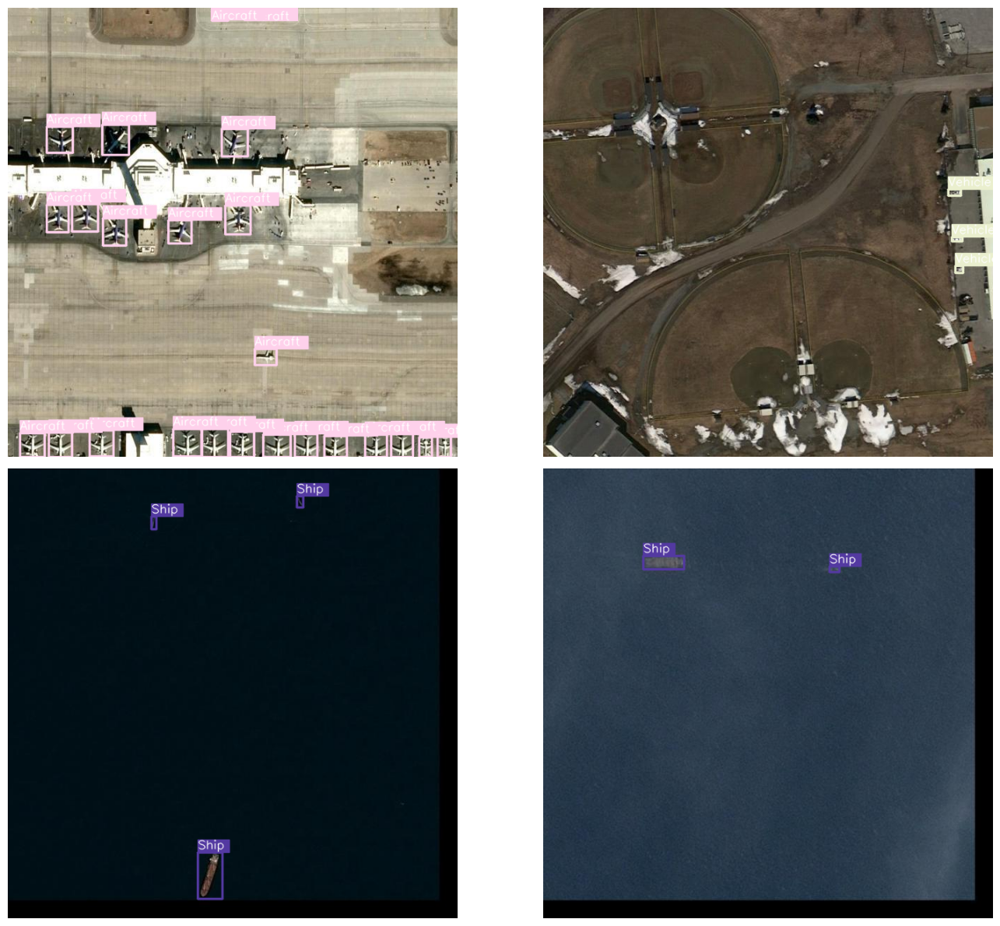

In [ ]:
# Visualize a few training images.
plot(
    image_path=os.path.join(ROOT_DIR, train_imgs_dir),
    label_path=os.path.join(ROOT_DIR, train_labels_dir),
    num_samples=4,
)

###Model Training
The YOLO-NAS model chosen for this task is the "medium model" (about 51.13M parameters).

The hyperparameters are chosen in order to optimize model precision, but most importantly to allow execution on Google Colab without a payed subscription.
Weights are initialized as COCO dataset weights.

In [ ]:
# Define training hyperparameters
EPOCHS = 20
BATCH_SIZE = 16
WORKERS = 8

In [ ]:
# Training data extraction
train_data = coco_detection_yolo_format_train(
    dataset_params={
        'data_dir': dataset_params['data_dir'],
        'images_dir': dataset_params['train_images_dir'],
        'labels_dir': dataset_params['train_labels_dir'],
        'classes': dataset_params['classes']
    },
    dataloader_params={
        'batch_size':BATCH_SIZE,
        'num_workers':WORKERS
    }
)

# Validation data extraction
val_data = coco_detection_yolo_format_val(
    dataset_params={
        'data_dir': dataset_params['data_dir'],
        'images_dir': dataset_params['val_images_dir'],
        'labels_dir': dataset_params['val_labels_dir'],
        'classes': dataset_params['classes']
    },
    dataloader_params={
        'batch_size':BATCH_SIZE,
        'num_workers':WORKERS
    }
)

[2024-05-09 17:41:13] INFO - detection_dataset.py - Dataset Initialization in progress. `cache_annotations=True` causes the process to take longer due to full dataset indexing.
Indexing dataset annotations: 100%|██████████| 2094/2094 [00:00<00:00, 4126.49it/s]
/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:558: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
[2024-05-09 17:41:13] INFO - detection_dataset.py - Dataset Initialization in progress. `cache_annotations=True` causes the process to take longer due to full dataset indexing.
Indexing dataset annotations: 100%|██████████| 449/449 [00:00<00:00, 3821.51it/s]


In [ ]:
# Training Parameters for Yolo-NAS object
train_params = {
    'torch_compile': True,
    'silent_mode': False,
    "average_best_models":True,
    "warmup_mode": "linear_epoch_step",
    "warmup_initial_lr": 1e-6,
    "lr_warmup_epochs": 3,
    "initial_lr": 5e-4,
    "lr_mode": "cosine",
    "cosine_final_lr_ratio": 0.1,
    "optimizer": "Adam",
    "optimizer_params": {"weight_decay": 0.0001},
    "zero_weight_decay_on_bias_and_bn": True,
    "ema": True,
    "ema_params": {"decay": 0.9, "decay_type": "threshold"},
    "max_epochs": EPOCHS,
    "mixed_precision": True,
    "loss": PPYoloELoss(
        use_static_assigner=False,
        num_classes=len(dataset_params['classes']),
        reg_max=16
    ),
    "valid_metrics_list": [
        DetectionMetrics_050(
            score_thres=0.1,
            top_k_predictions=300,
            num_cls=len(dataset_params['classes']),
            normalize_targets=True,
            post_prediction_callback=PPYoloEPostPredictionCallback(
                score_threshold=0.01,
                nms_top_k=1000,
                max_predictions=300,
                nms_threshold=0.7
            )
        ),
        DetectionMetrics_050_095(
            score_thres=0.1,
            top_k_predictions=300,
            num_cls=len(dataset_params['classes']),
            normalize_targets=True,
            post_prediction_callback=PPYoloEPostPredictionCallback(
                score_threshold=0.01,
                nms_top_k=1000,
                max_predictions=300,
                nms_threshold=0.7
            )
        )
    ],
    "metric_to_watch": 'mAP@0.50:0.95'
}

In [ ]:
# Model selection (S, M, L). Uncomment the chosen one
models_to_train = [
    #'yolo_nas_s',
    'yolo_nas_m',
    #'yolo_nas_l'
]

During training, SuperGradients saves checkpoints (such as the Best model so far) so that training can be resumed or weights con be restored as for some saved checkpoint.

In [ ]:
# Define checkpoint directory
CHECKPOINT_DIR = 'checkpoints'

In [ ]:
# Model training
for model_to_train in models_to_train:
    trainer = Trainer(
        experiment_name=model_to_train,
        ckpt_root_dir=CHECKPOINT_DIR
    )

    model = models.get(
        model_to_train,
        num_classes=len(dataset_params['classes']),
        pretrained_weights="coco"
    )

    trainer.train(
        model=model,
        training_params=train_params,
        train_loader=train_data,
        valid_loader=val_data
    )

[2024-04-30 12:45:57] INFO - sg_trainer.py - Using torch.compile feature. Compiling model. This may take a few minutes
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
[2024-04-30 12:45:58] INFO - sg_trainer.py - Model compilation complete. Continuing training
[2024-04-30 12:45:58] INFO - sg_trainer.py - Starting a new run with `run_id=RUN_20240430_124558_128700`
[2024-04-30 12:45:58] INFO - sg_trainer.py - Checkpoints directory: checkpoints/yolo_nas_m/RUN_20240430_124558_128700
[2024-04-30 12:45:58] INFO - sg_trainer.py - Using EMA with params {'decay': 0.9, 'decay_type': 'threshold'}
/usr/local/lib/python3.10/dist-packages/super_gradients/training/utils/ema.py:65: UserWarning: Warning: EMA should be used with SgModule instance. All attributes of the model will be included in EMA
  warnings.warn("Warning:

The console stream is now moved to checkpoints/yolo_nas_m/RUN_20240430_124558_128700/console_Apr30_12_45_58.txt


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
skipping cudagraphs due to ['non-cuda device in graph']
Train epoch 0:   7%|▋         | 9/130 [05:49<15:13,  7.55s/it, PPYoloELoss/loss=1.59, PPYoloELoss/loss_cls=0.703, PPYoloELoss/loss_dfl=0.35, PPYoloELoss/loss_iou=0.54, gpu_mem=13]

## Export Trained Model and Upload to Google Drive
After training a "good model" (for instance with 50 epochs) use this code to save it on google drive. Directory and file name (yolo_NAS.pth) can be modified at will.

In [ ]:
model = model.eval()
save_path = "/content/drive/MyDrive/Project_Intelligent/Trained_Models/yolo_NAS(M)_Sky(" + str(EPOCHS)+ "EP).pth"
torch.save(model, save_path)

##Import Model from Google drive
Import trained model from google drive. Specify the right directory and file name to retrieve the "*.pth" file.

Model size (S,M,L) must be set to the same one as the model you want to import, since number of parameters must match

**NOTE:**
All models available on our Google Drive Folder are CUDA models, which means that inference on non-CUDA devices is impossibile without proper conversion.

In [ ]:
# Create a "basic" model OF THE SAME KIND as the model you want to import
model_imp = models.get(
        # Careful here, set the right size
        'yolo_nas_m',
        num_classes=len(dataset_params['classes']),
        pretrained_weights="coco"
    )

# Specify directory where model is stored
load_path = "/content/drive/MyDrive/Project_Intelligent/Trained_Models/yolo_NAS(M)_Sky(" + str(EPOCHS)+ "EP).pth"
# Move model from CPU to GPU (much faster testing)
model_imp = model_imp.to('cuda')

# Import and Prepare for testing
model_imp = torch.load(load_path)
model_imp = model_imp.eval();


[2024-05-09 17:41:32] WARNING - checkpoint_utils.py - :warning: The pre-trained models provided by SuperGradients may have their own licenses or terms and conditions derived from the dataset used for pre-training.
 It is your responsibility to determine whether you have permission to use the models for your use case.
 The model you have requested was pre-trained on the coco dataset, published under the following terms: https://cocodataset.org/#termsofuse
[2024-05-09 17:41:32] INFO - checkpoint_utils.py - License Notification: YOLO-NAS pre-trained weights are subjected to the specific license terms and conditions detailed in 
https://github.com/Deci-AI/super-gradients/blob/master/LICENSE.YOLONAS.md
By downloading the pre-trained weight files you agree to comply with these terms.
Downloading: "https://sghub.deci.ai/models/yolo_nas_m_coco.pth" to /root/.cache/torch/hub/checkpoints/yolo_nas_m_coco.pth
100%|██████████| 196M/196M [00:07<00:00, 28.8MB/s]
[2024-05-09 17:41:40] INFO - checkpoin

## Testing
In this section, we perform object detection on our test set. However, any satellite image witha a "decent" resolution can be used for calling the "predict()" function. For instance, you can test it on any screenshot taken from Google Maps/Earth.

All "predictions" are saved in the desired folder, as "post-processed" images that already contain a visualization of the predicted bounding boxes.

In [ ]:
# Create Folder to save Inference Results
os.makedirs('inference_results/images/', exist_ok=True)

# Specify path to test images
ROOT_TEST = 'SkyFusion-YOLO/test/images/'
all_images = os.listdir(ROOT_TEST)

In [ ]:
# Execute object detection
for image in tqdm(all_images, total=len(all_images)):
    image_path = os.path.join(ROOT_TEST, image)
    out = model_imp.predict(image_path)
    string = 'inference_results/images/' + image
    out.save(string)

  0%|          | 0/30 [00:00<?, ?it/s]

[2024-05-09 17:42:13] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`
[2024-05-09 17:42:16] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`
[2024-05-09 17:42:17] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`
[2024-05-09 17:42:17] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`
[2024-05-09 17:42:18] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`
[2024-05-09 17:42:19] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`
[2024-05-09 17:42:19] INFO -

### Plot some predicted images to visualize the predicted bounding boxes

In [ ]:
classes = ['Aircraft', 'Ship', 'Vehicle']

In [ ]:
# Function to convert bounding boxes in YOLO format to xmin, ymin, xmax, ymax.
def yolo2bbox(bboxes):
    xmin, ymin = bboxes[0]-bboxes[2]/2, bboxes[1]-bboxes[3]/2
    xmax, ymax = bboxes[0]+bboxes[2]/2, bboxes[1]+bboxes[3]/2
    return xmin, ymin, xmax, ymax

In [ ]:
def plot_box(image, bboxes, labels):
    # Need the image height and width to denormalize
    # the bounding box coordinates
    height, width, _ = image.shape
    lw = max(round(sum(image.shape) / 2 * 0.003), 2)  # Line width.
    tf = max(lw - 1, 1) # Font thickness.
    for box_num, box in enumerate(bboxes):
        x1, y1, x2, y2 = yolo2bbox(box)
        # denormalize the coordinates
        xmin = int(x1*width)
        ymin = int(y1*height)
        xmax = int(x2*width)
        ymax = int(y2*height)

        p1, p2 = (int(xmin), int(ymin)), (int(xmax), int(ymax))

        class_name = classes[int(labels[box_num])]

        color = (0, 0, 255)

        cv2.rectangle(
            image,
            p1, p2,
            color=color,
            thickness=lw,
            lineType=cv2.LINE_AA
        )

        # For filled rectangle.
        w, h = cv2.getTextSize(
            class_name,
            0,
            fontScale=lw / 3,
            thickness=tf
        )[0]

        outside = p1[1] - h >= 3
        new_p2 = p1[0] + w, p2[1] + h + 3 if outside else p2[1] - h - 3

        cv2.rectangle(
            image,
            (p1[0], p2[1]), new_p2,
            color=color,
            thickness=-1,
            lineType=cv2.LINE_AA
        )
        cv2.putText(
            image,
            class_name,
            (p1[0], p2[1] + h + 2 if outside else p2[1]),
            cv2.FONT_HERSHEY_SIMPLEX,
            fontScale=lw/3,
            color=(255, 255, 255),
            thickness=tf,
            lineType=cv2.LINE_AA
        )
    return image

In [ ]:
# Function to plot images with the bounding boxes.
def plot(image_path, label_path, num_samples):
    all_training_images = glob.glob(image_path+'/*')
    all_training_labels = glob.glob(label_path+'/*')
    all_training_images.sort()
    all_training_labels.sort()

    temp = list(zip(all_training_images, all_training_labels))
    random.shuffle(temp)
    all_training_images, all_training_labels = zip(*temp)
    all_training_images, all_training_labels = list(all_training_images), list(all_training_labels)

    num_images = len(all_training_images)

    if num_samples == -1:
        num_samples = num_images

    for i in range(num_samples):
        image_name = all_training_images[i].split(os.path.sep)[-1]
        print(image_name)
        image = cv2.imread(all_training_images[i])
        with open(all_training_labels[i], 'r') as f:
            bboxes = []
            labels = []
            label_lines = f.readlines()
            for label_line in label_lines:
                label, x_c, y_c, w, h = label_line.split(' ')
                x_c = float(x_c)
                y_c = float(y_c)
                w = float(w)
                h = float(h)
                bboxes.append([x_c, y_c, w, h])
                labels.append(label)
        result_image = plot_box(image, bboxes, labels)
        plt.figure(figsize=(12, 9))
        plt.imshow(image[:, :, ::-1])
        plt.axis('off')
        plt.show()

m0231_png.rf.571f62f140b13cabe469b683dfcbe777.jpg


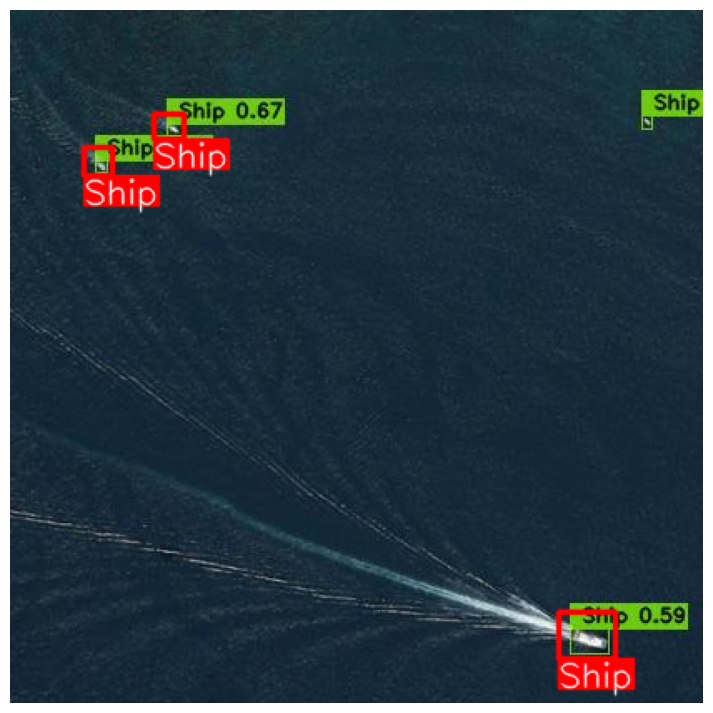

P2271__1-0__0___1200_png_jpg.rf.b4db15c921dbfd136487fb8b614e6bd7.jpg


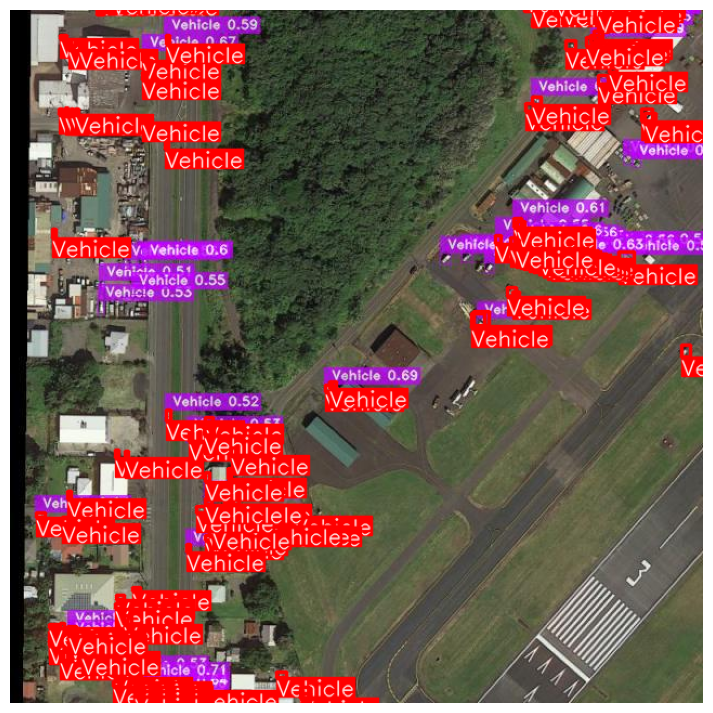

P1412__1-0__3000___0_png_jpg.rf.25fbc56ac03ff7cee4deb3d37cd9f3c2.jpg


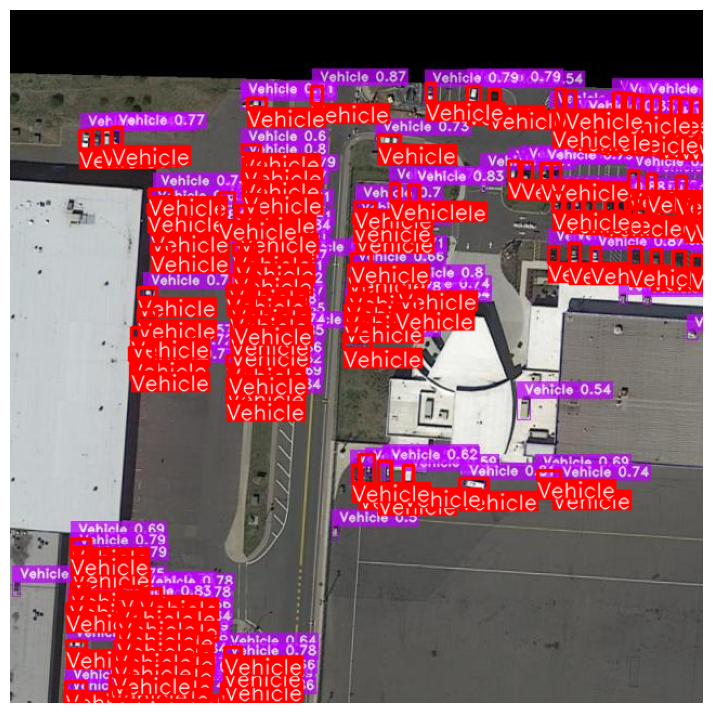

babb0ef2-ef2d-4cab-b3e2-230ae2418cdc_0_1060_jpg.rf.1bb9aecaa5509090c6fa1c584c91a8b4.jpg


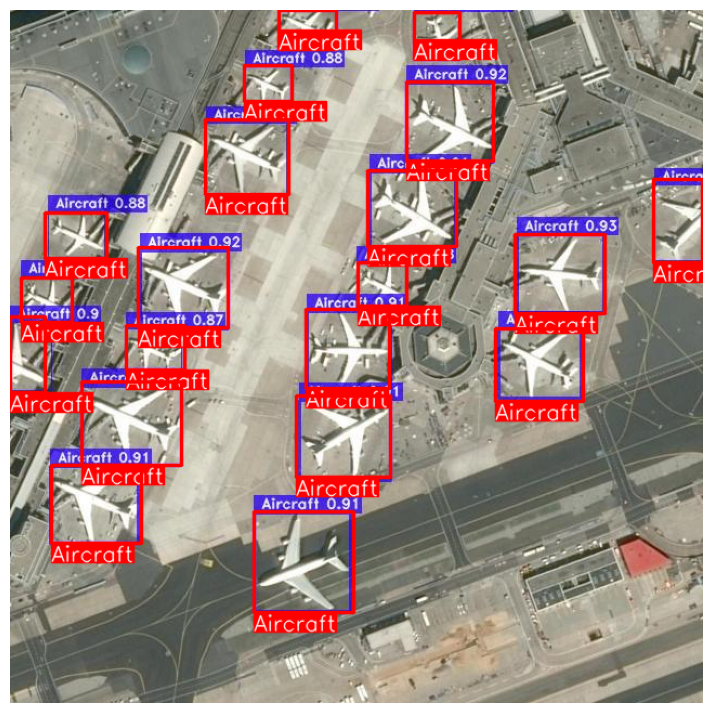

12341_png_jpg.rf.f690f432818fd8b81949a2dec8e7eb32.jpg


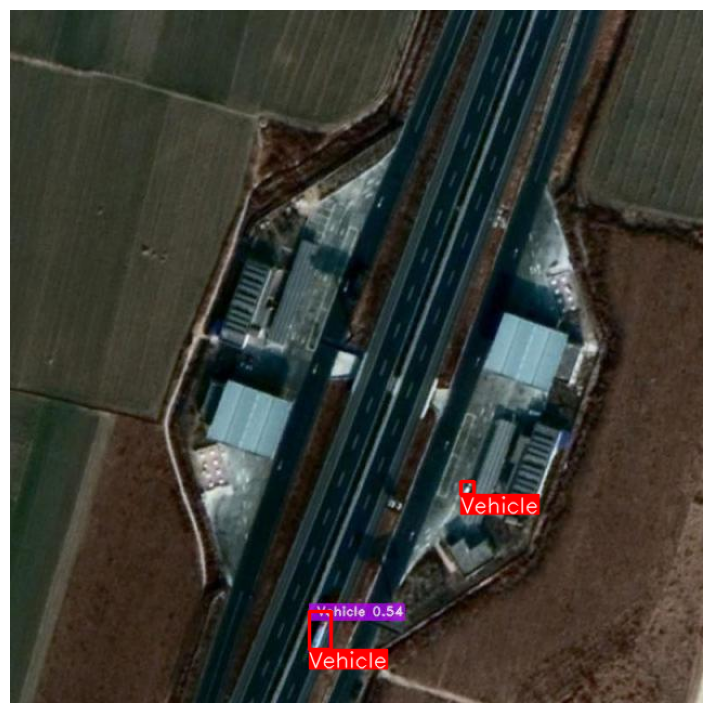

6627e7c7-2fdd-4f3c-965e-b4d73d0a4cc2_0_1060_jpg.rf.658bc53e8c6007b2cba90cc9906f2943.jpg


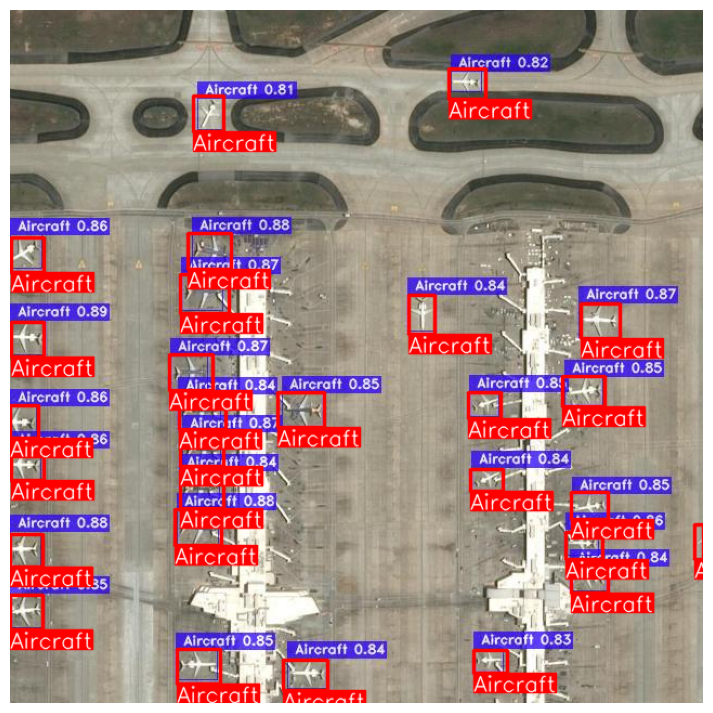

5c9e817a-dc4b-42ab-952c-3128e2de12e8_0_1060_jpg.rf.641aff1b84aac2575b4cf7ac29ee0b01.jpg


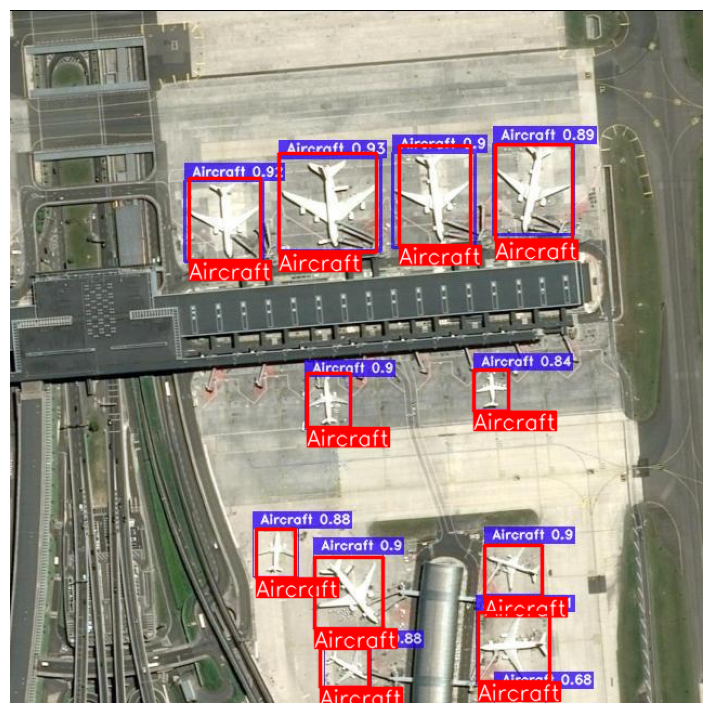

043d8815e_jpg.rf.702fa31e03a8a1c28e5fb63c561ac16e.jpg


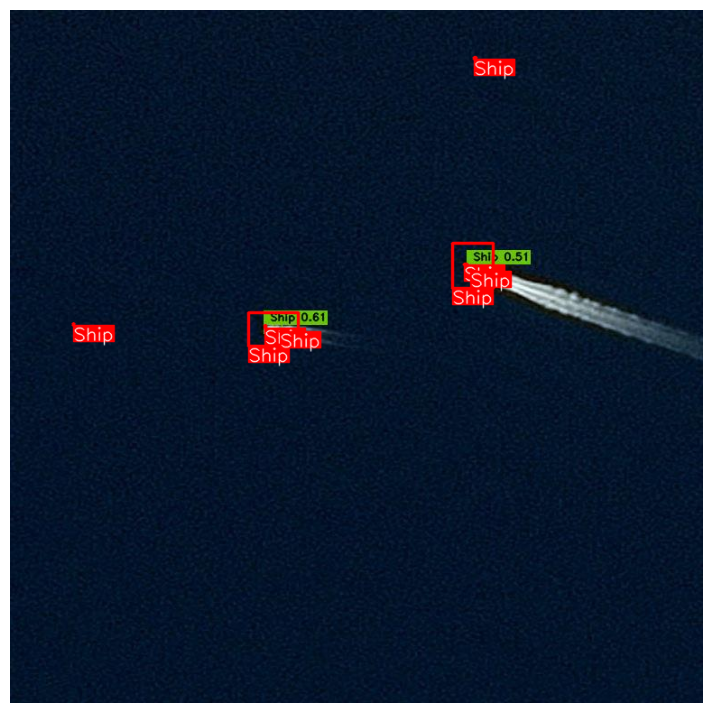

bfc53eb0-eb57-4dd7-8c1e-8e42ba49757b_0_0_jpg.rf.7a768b7d64bc271ec472388711062e31.jpg


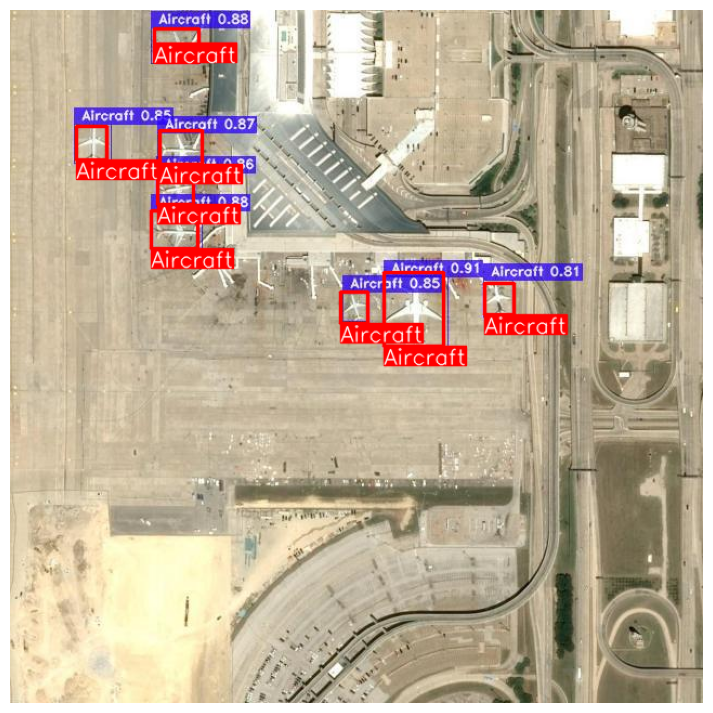

P1871__1-0__6000___0_png_jpg.rf.c27e729379df1ddae77c5d691eca8beb.jpg


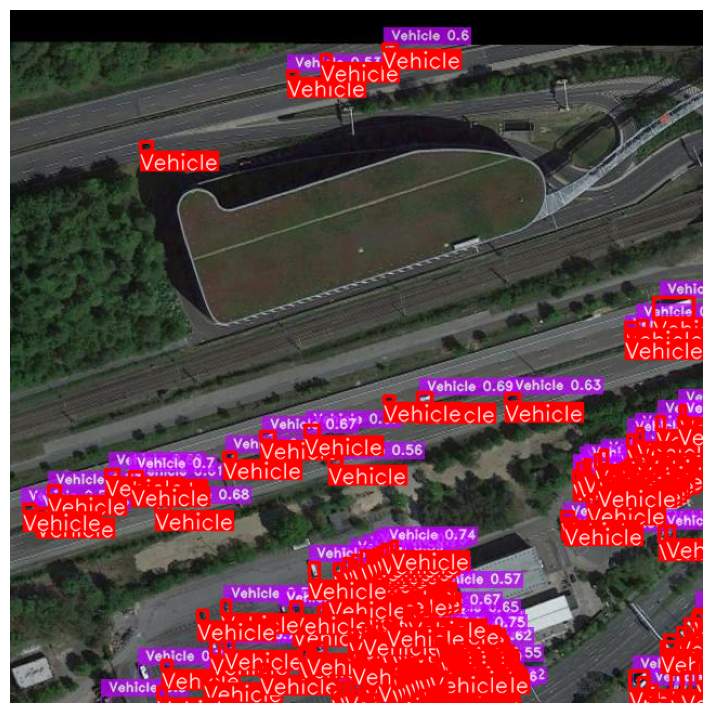

P2771__1-0__1697___600_png_jpg.rf.588a84ca3aed1edff5ed59fe2967ef4c.jpg


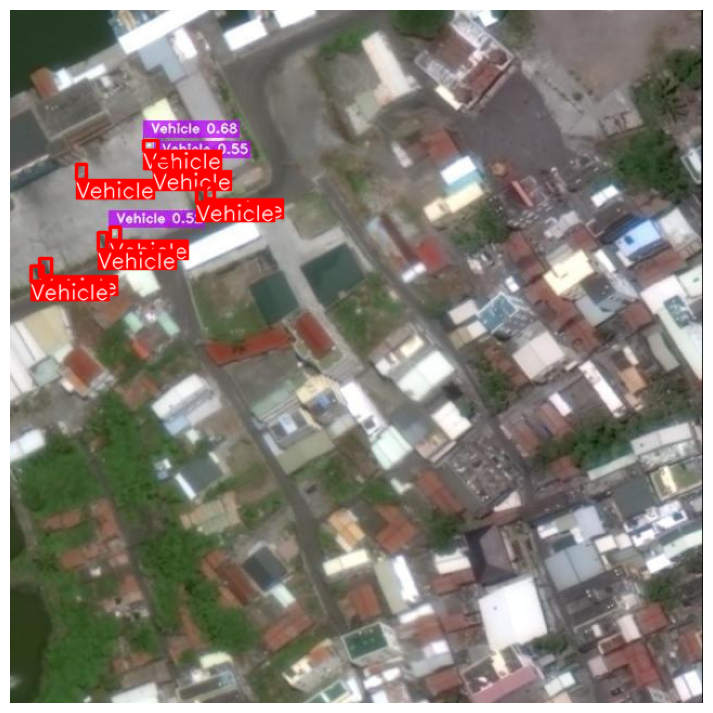

3f823ec02_png_jpg.rf.303cf4dcb8301f726716d672fb4c7bd5.jpg


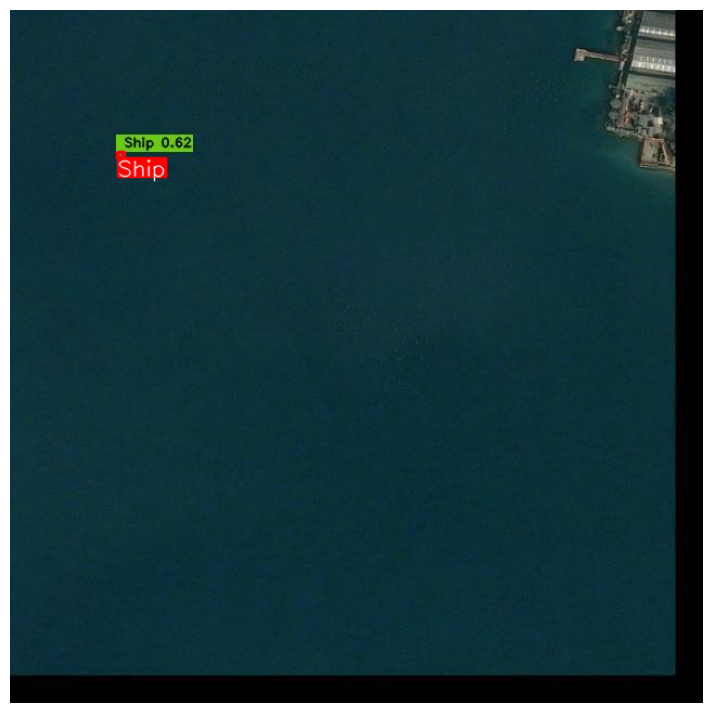

14055_png_jpg.rf.aa2fcd4d6ef5ec5c361d17d1fe74c4d1.jpg


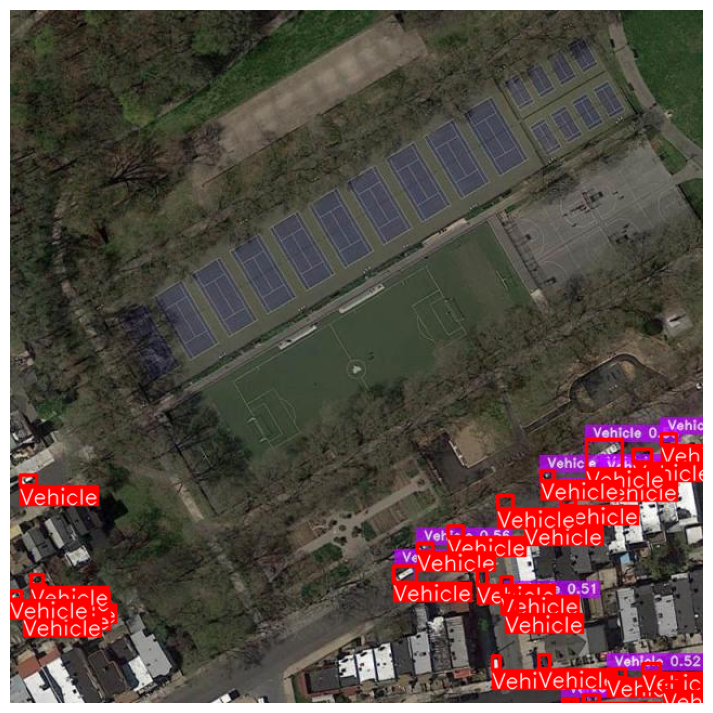

27f8e6ba0_jpg.rf.e0b9a59a991cf3f5369d34777c214c97.jpg


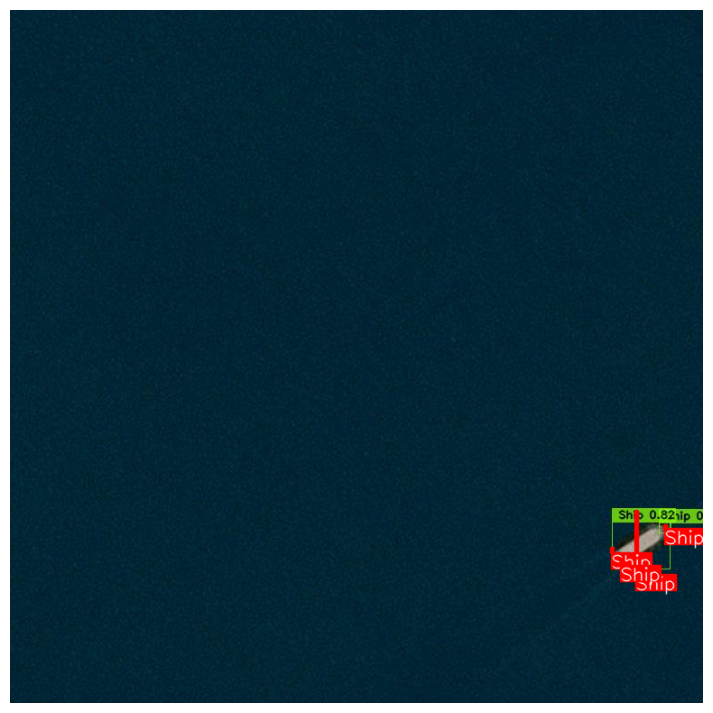

12993_png_jpg.rf.1e0daa145cb5eb5df98f8ec04c6b808f.jpg


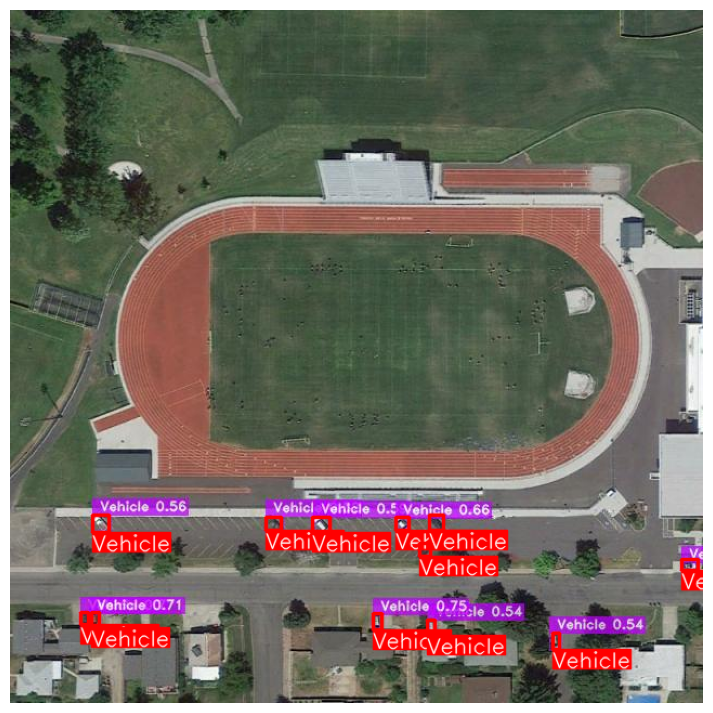

ae2fddcd-a2b4-4f32-b86d-ac2c2b03d77d_1060_0_jpg.rf.a2f480be9ad7110610c21298333e50fe.jpg


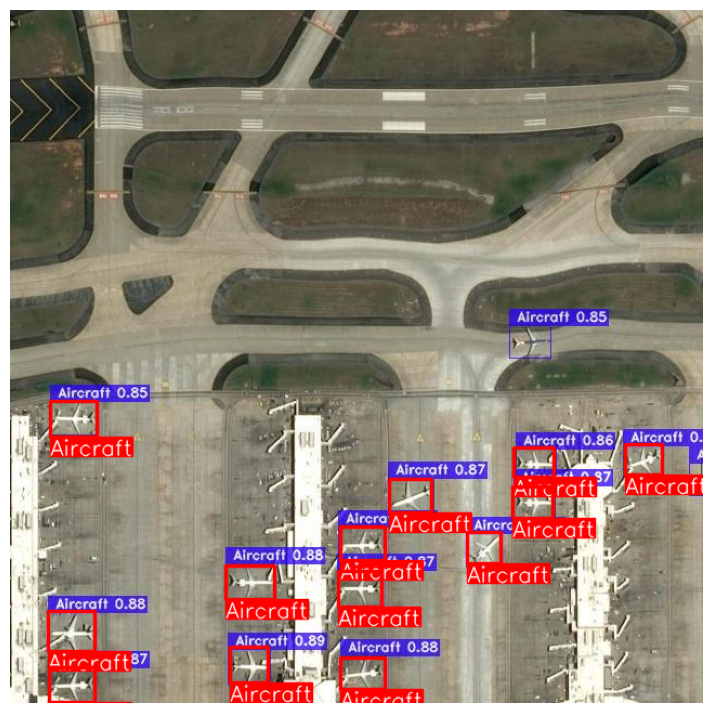

P2491__1-0__1200___1200_png_jpg.rf.4d34b37d88e6138a7206a088dccaaa50.jpg


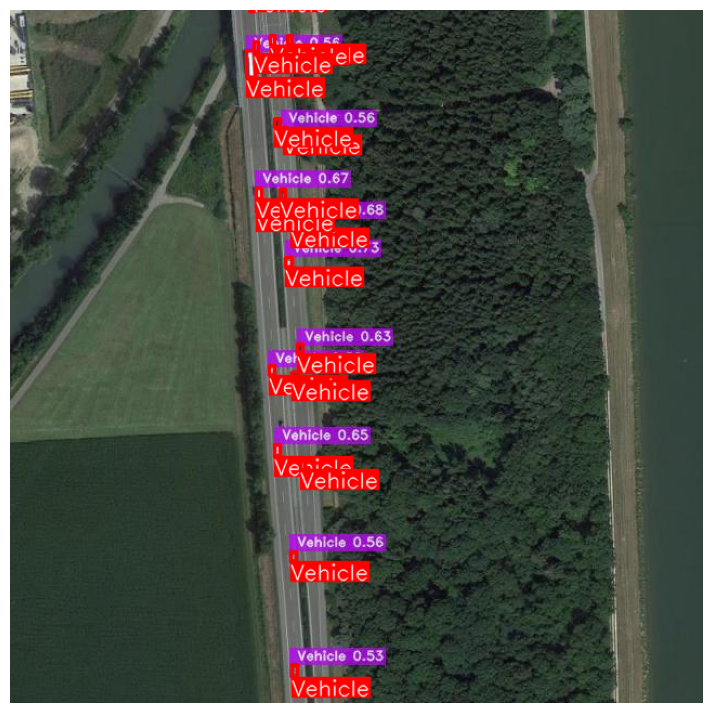

3bcc868f8_png_jpg.rf.3ecbca840986bec7d67aa04a32ac05c7.jpg


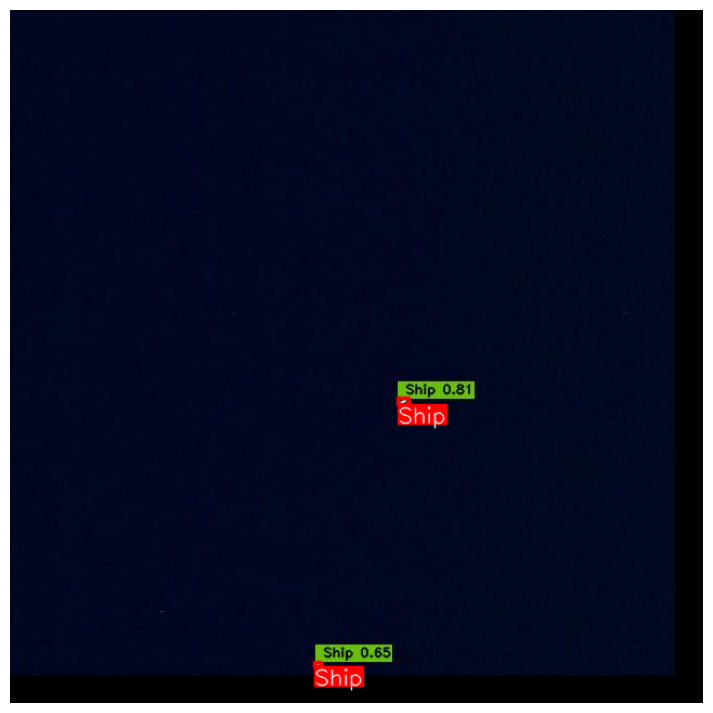

03f84930-e2be-4c19-9afc-0dc26d02538e_1060_0_jpg.rf.7b74e81d9e8d7e2c424cfd39ee4aff3a.jpg


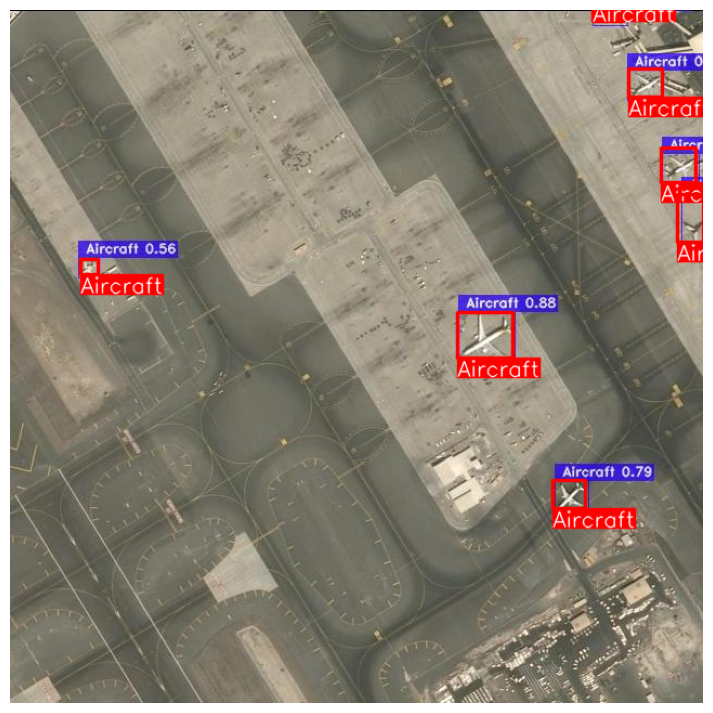

skagen2subset6_two_ships_png.rf.8e0d2e350fa7e634a9ae4c33588d5534.jpg


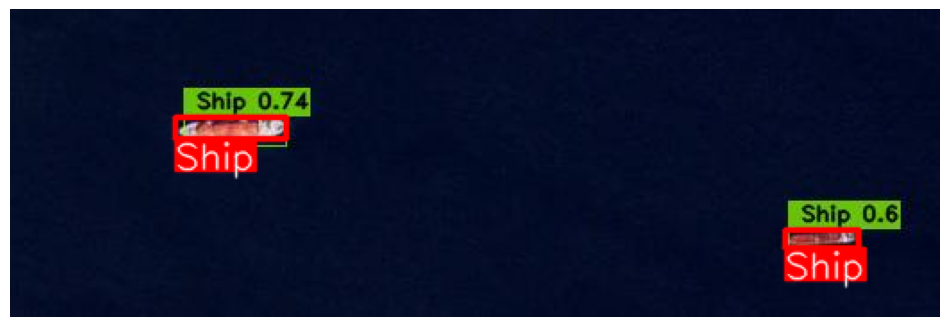

m0141_png.rf.2e87bf15a048c7be401b7b329ff33507.jpg


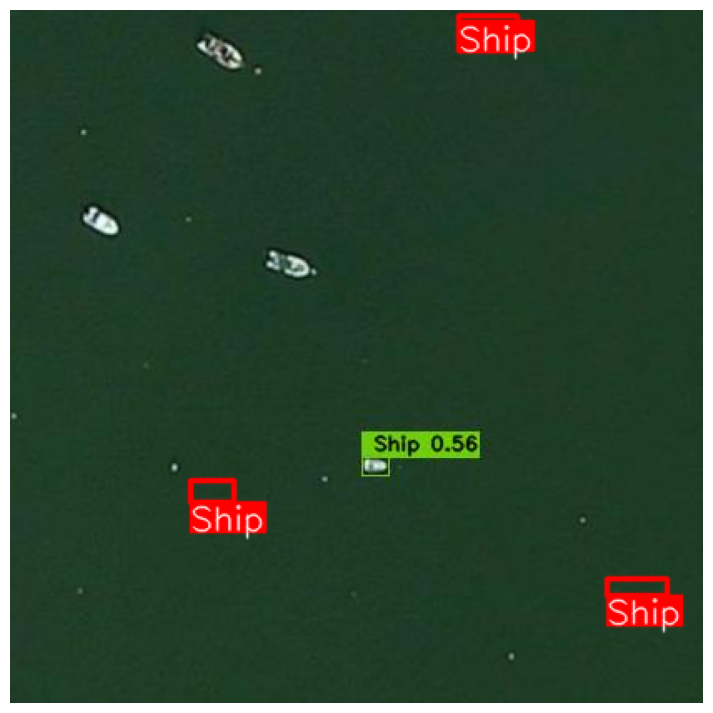

7635d63c-6b97-4c9c-a7dc-27773d42ed4c_1060_1060_jpg.rf.addba941730b0e52189eb65b4773d3b4.jpg


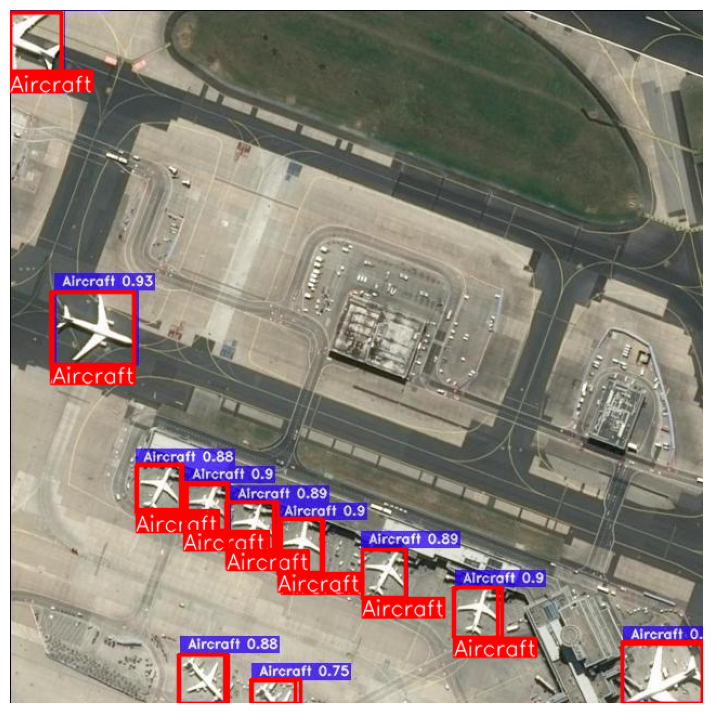

6a16be624_png_jpg.rf.c37ff74fbbfd3fb488b31ac25e5c4f12.jpg


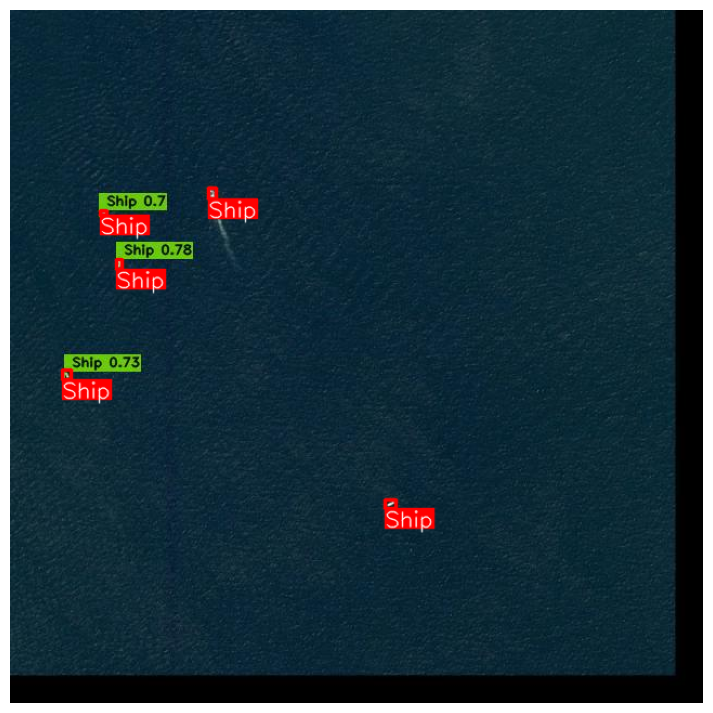

24d61fdda_jpg.rf.1518454df86bc76d2bbfc5e9f0e0bb5c.jpg


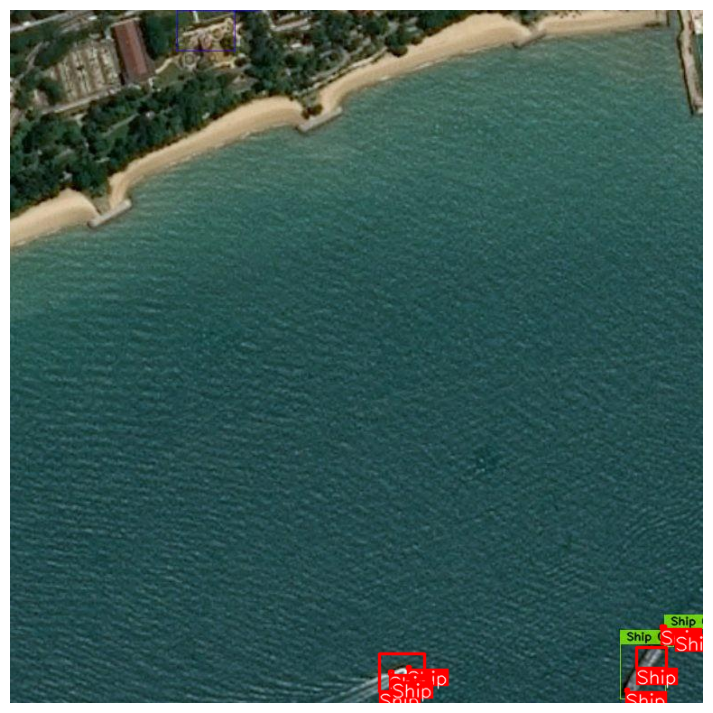

ad36e699-4a1f-4891-b579-6e9ac3e54235_1060_0_jpg.rf.a7aaf60fce4cd4a2c5538daf5e724d35.jpg


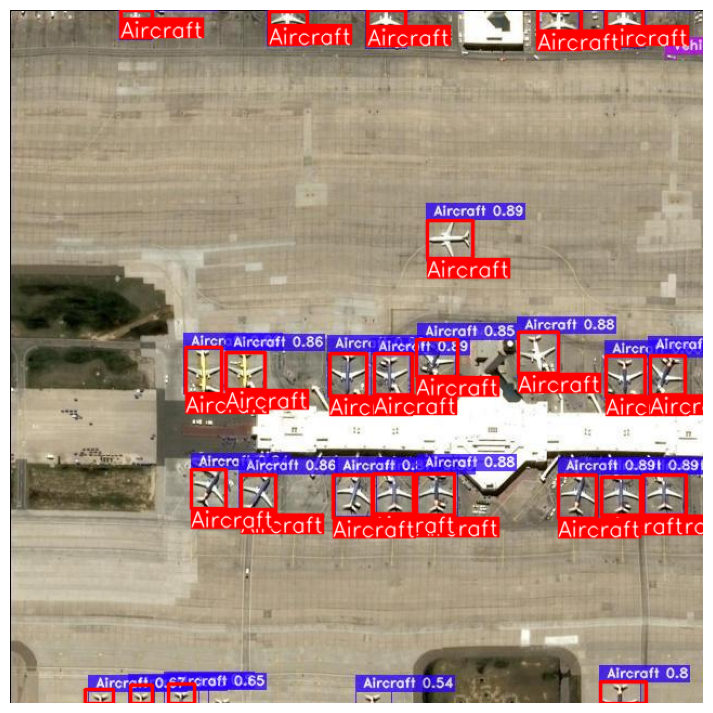

4c190f1c7_jpg.rf.94027115e18176ef5763491f1ec6b4ef.jpg


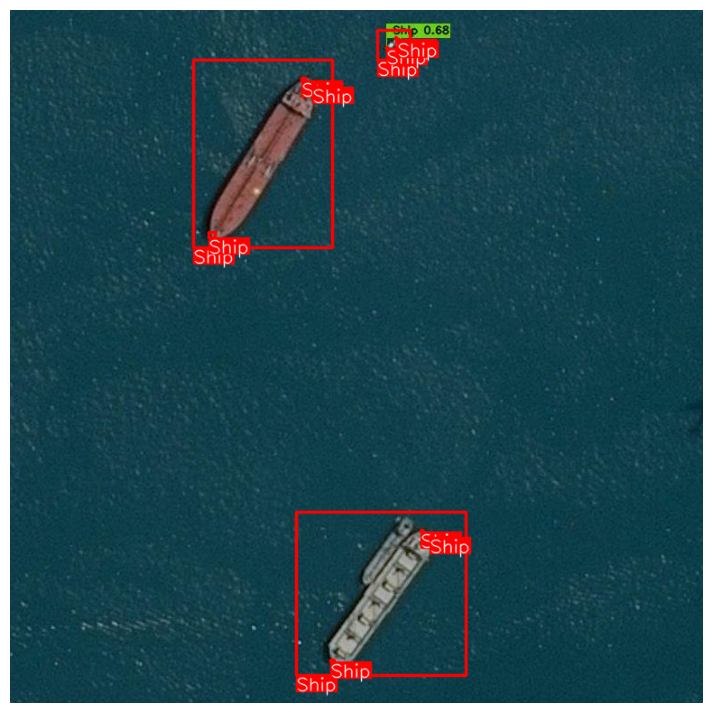

d8873734-016a-4b9d-9b9e-8bc47eb13fef_0_0_jpg.rf.02eac11fb50d2eb6848b3a8d1a238c4a.jpg


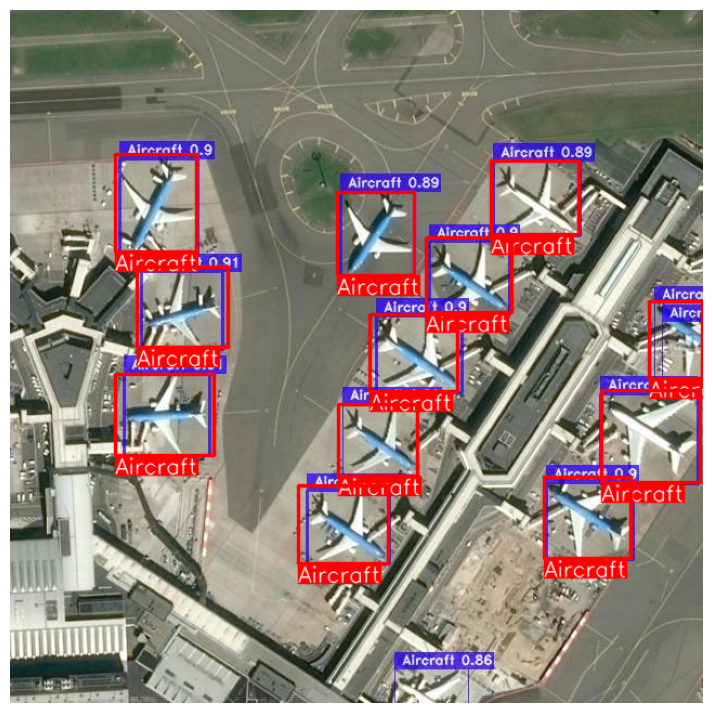

d3d2b706-9017-41f4-b57e-469038daa634_1060_1060_jpg.rf.87b635ed099d43e86f80c63f368f77ee.jpg


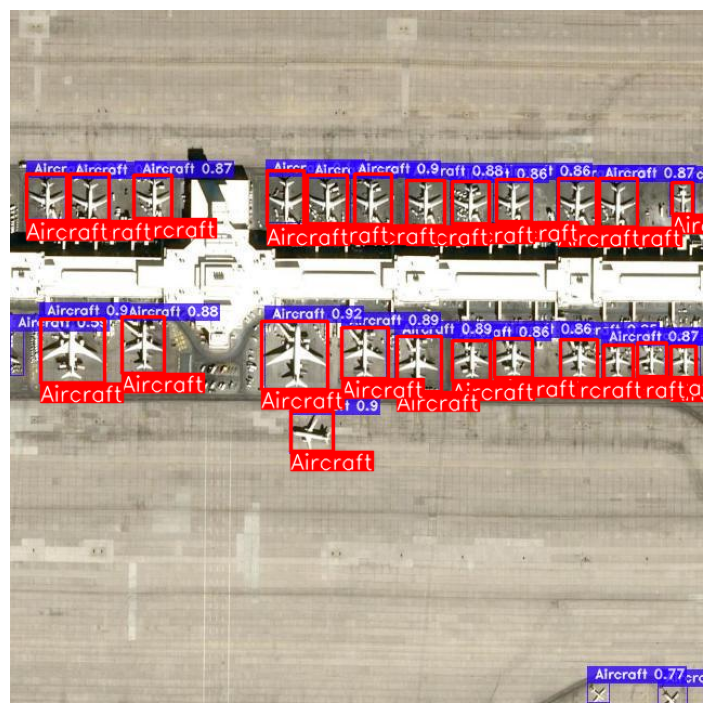

P1459__1-0__3600___0_png_jpg.rf.156b5f4c685a2c0afbe367687b4257c3.jpg


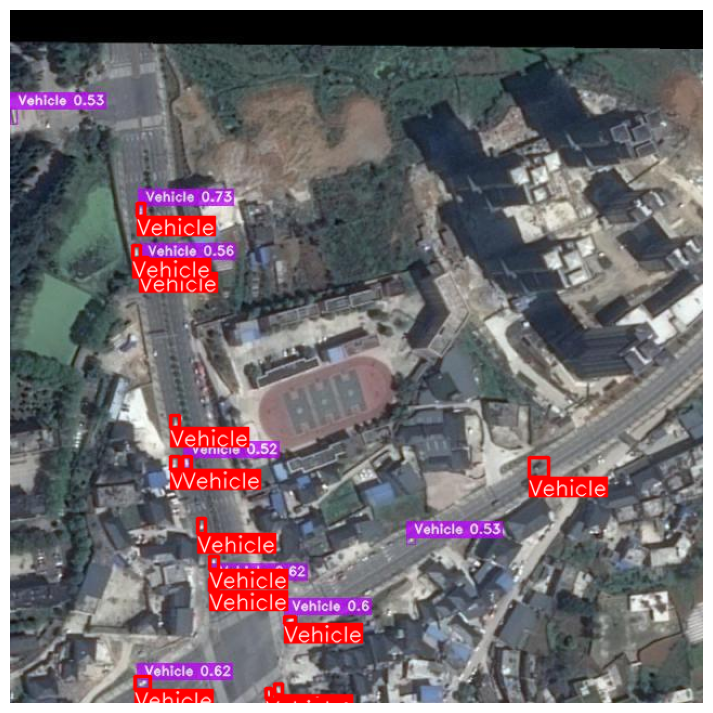

x0045_png.rf.79c39def0642370aa94c915880e2564a.jpg


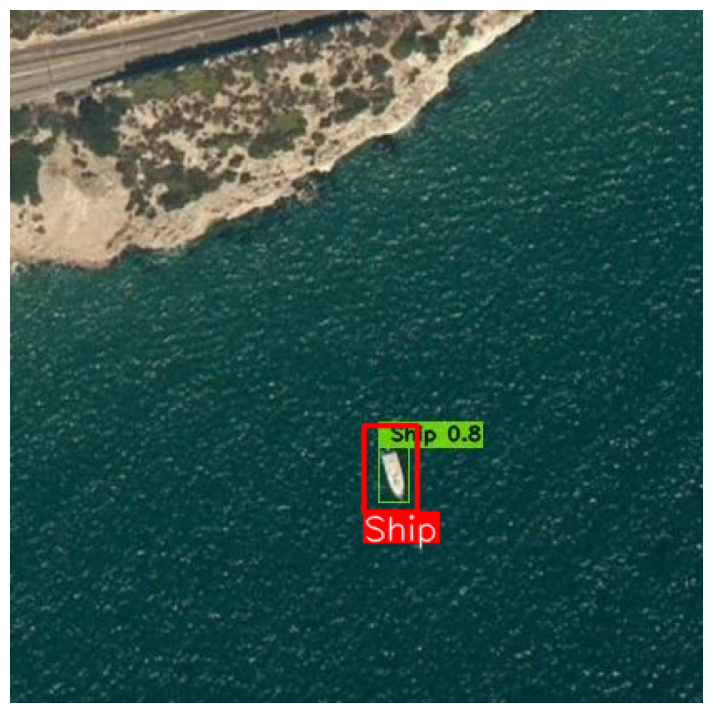

In [ ]:
# Visualize a few test images.
plot(
    image_path='inference_results/images/',
    label_path='SkyFusion-YOLO/test/labels/',
    num_samples=30,
)

### Video Object Detection
Using Google Earth pro, we created two videos that simulate some aerial footage, as if the videos where shot by some kind of drone or high resolution satellite.
We chose two very different location, namely **Fiumicino Airport** and **Hawaii**, so to try to test our trained model on some disparate environments.

Results are once again promising in both settings, with very good performance on vehicles and some higher inaccuracy on boats, due to Dataset limitations.

In [ ]:
# Video Prediction 1 - Fiumicino
dest_path1 = "/content/Sky_Fiumicino_predicted.mp4"
input_video_path1 = '/content/drive/MyDrive/Project_Intelligent/Videos/Sky_Fiumicino.mp4'

out1 = model_imp.predict(input_video_path1)
out1.save(dest_path1)

Processing Video: 100%|█████████▉| 1291/1296 [10:23<00:00, 11.85it/s]

In [ ]:
# Video Prediction 2 - Hawaii
dest_path2 = "/content/Sky_Hawaii_predicted.mp4"
input_video_path2 = '/content/drive/MyDrive/Project_Intelligent/Videos/Sky_Hawaii.mp4'

out1 = model_imp.predict(input_video_path2)
out1.save(dest_path2)

Processing Video: 100%|█████████▉| 1568/1569 [10:05<00:01,  1.78s/it]

In [ ]:
#Load on Google Drive
import shutil

google_drive_path = "/content/drive/MyDrive/Project_Intelligent/Videos"

shutil.copy(dest_path1, google_drive_path)
shutil.copy(dest_path2, google_drive_path)

print("Files copied to Google Drive")

Files copied to Google Drive


## Auxiliary Funcitons

In [ ]:
# Delete folder contents
def delete_folder_contents(folder_path):
    files = os.listdir(folder_path)

    for file in files:
        file_path = os.path.join(folder_path, file)
        if os.path.isfile(file_path):
            os.remove(file_path)
        elif os.path.isdir(file_path):
            delete_folder_contents(file_path)
            os.rmdir(file_path)


#delete_folder_contents('inference_results/images/')